<a href="https://colab.research.google.com/github/yassmin1/311_services_city_SATX/blob/main/311_SA_GeoAnalysis.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Mapping

In [ ]:
!apt install python3-folium  # For folium and it's necessary to plot the gpd.explore
!pip install descartes
!pip install contextily


In [ ]:
import geopandas as gpd
from shapely.geometry import Point
from pyproj import CRS, Transformer,Proj
import folium
from folium.plugins import HeatMap
import webbrowser
import os
import contextily as cx
from matplotlib.colors import rgb2hex,to_hex,ListedColormap,cnames
import seaborn as sns
from sklearn.utils import resample



In [ ]:
df=pd.read_csv('/content/drive/MyDrive/SanAntonioCity311/311_clean.csv')

In [ ]:
df[['YCOORD','XCOORD']].head()

,YCOORD,XCOORD
0,13701301.0,2132800.0
1,13701518.0,2131367.0
2,13720933.0,2169110.0
3,13704818.0,2124338.0
4,13696572.0,2146878.0


In [ ]:


# Define CRS objects for UTM and WGS84 (used for latitude and longitude)
utm_crs = CRS.from_epsg( 3674  )#32614)# ET:3081)#26914)
wgs84_crs = CRS.from_epsg(4326 )#4326) 4152,4204 # EPSG code for WGS84
#wgs84_crs = CRS.from_epsg(3857)
print(wgs84_crs)
# Create a transformer object
transformer = Transformer.from_crs(utm_crs, wgs84_crs)
easting_coords=df['XCOORD']
northing_coords=df['YCOORD']

# Transform each coordinate pair (Easting, Northing) to (latitude, longitude)
lat_list = []
lon_list = []
for easting, northing in zip(easting_coords, northing_coords):
  lat, lon = transformer.transform(easting, northing)
  lat_list.append(lat)
  lon_list.append(lon)

df["lat"]=lat_list
df["lon"]=lon_list
df[['lat', 'lon','Category']]

EPSG:4326


,lat,lon,Category
0,29.421893,-98.483869,Dockless Vehicle
1,29.422507,-98.488367,Dockless Vehicle
2,29.475395,-98.369474,Streets & Infrastructure
3,29.431666,-98.510405,Animals
4,29.408709,-98.439716,Animals
...,...,...,...
575074,29.433034,-98.465571,Animals
575075,29.575311,-98.629121,Animals
575076,29.441727,-98.582815,Animals
575077,29.420643,-98.644207,Animals


## output csv file

In [ ]:
# save file with lot lon
# new features
df['month']=pd.to_datetime(df['OPENEDDATETIME']).dt.month.astype(object)
df['year']=pd.to_datetime(df['OPENEDDATETIME']).dt.year.astype(object)
df['day_of_week']=pd.to_datetime(df['OPENEDDATETIME']).dt.dayofweek.astype(object)
output="/content/drive/MyDrive/SanAntonioCity311/311_data_lat_lon.csv"
df.to_csv(output)

In [ ]:
#Mapping
selected_df=df[[ 'lon','lat','Category','time_interval']]
WGS84 = CRS('epsg:4326')
crs=CRS('EPSG:3857')
geometry = [Point(xy) for xy in zip(selected_df.lon, selected_df.lat)]
geometry[:3]

[<POINT (-98.484 29.422)>, <POINT (-98.488 29.423)>, <POINT (-98.369 29.475)>]

In [ ]:
# Map plotting
# Step 1: Create a GeoDataFrame

gdf = gpd.GeoDataFrame(selected_df, geometry=gpd.points_from_xy(selected_df.lon, selected_df.lat),crs=WGS84)
gdf.head()
print(gdf.crs)

gdf1=gdf.to_crs(crs)
print(gdf1.crs)


epsg:4326
EPSG:3857


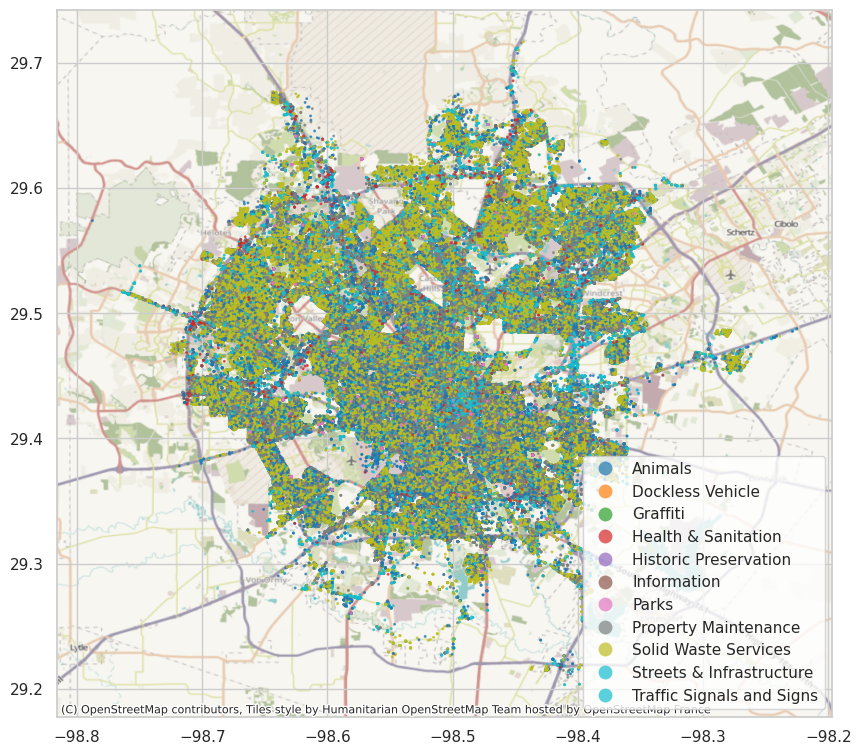

In [ ]:

# Set the basemap CRS to WGS84
ax=gdf.plot(column='Category', categorical=True, legend=True,figsize=(10, 10),marker= '.',markersize=5,alpha=0.7 )
cx.add_basemap(ax=ax,crs="epsg:4326")


### The problem is that GeoJSON files tend to be large and an alternative would be using TopoJSON.

In [ ]:
cat_n=gdf1["Category"].unique().tolist()
print(cat_n)
color_map=dict(zip(cat_n,sns.color_palette('husl', n_colors=len(cat_n))))
gdf1= gdf1.assign(color=df['Category'].map(color_map).map(rgb2hex))


['Dockless Vehicle', 'Streets & Infrastructure', 'Animals', 'Property Maintenance', 'Traffic Signals and Signs', 'Parks', 'Health & Sanitation', 'Information', 'Historic Preservation', 'Solid Waste Services', 'Graffiti']


In [ ]:
# resampling becuase the dataset is large
# Define sample size
sample_size = 10000
# Stratified sampling (ensures class proportion is preserved)
gdf1_sample = resample(gdf1, n_samples=sample_size,
                       replace=False, stratify=gdf1['Category'])
#
m=folium.Map(location=(29.4, -98.50),max_bounds=False,width='80%',height='70%')
#color_name=pd.DataFrame(cnames,index=[0]).T.reset_index().rename(columns={'index':'color'})['color'].values[:(len(cat_n))]
color_name=['red', 'orange', 'yellow', 'green', 'blue', 'brown', 'violet', 'black'][:(len(cat_n))]
for cat, color in zip(cat_n,color_name):
    print(cat)
    #color=gdf1_sample[gdf1_sample["Category"] == cat]['color'].unique().tolist()
    print(color)
    #color=ListedColormap([color])
    #print(color) cmap=str(color),
    gdf1_sample[gdf1_sample["Category"] == cat].explore(m=m,categorical=True,
            legend=False,name=cat,marker_type='circle',
            marker_kwds=dict(radius=2,fill=True),color=color,
            style_kwds=dict(fill=True))

##
folium.TileLayer("CartoDB positron", show=False).add_to(m)
folium.TileLayer("OpenStreetMap").add_to(m)
folium.LayerControl().add_to(m)
# and then we write the map to disk
#m.save('my_map.html')

# then open it
#webbrowser.open(r'/content/my_map.html')
m



Dockless Vehicle
red
Streets & Infrastructure
orange
Animals
yellow
Property Maintenance
green
Traffic Signals and Signs
blue
Parks
brown
Health & Sanitation
violet
Information
black


##Folium Mapping

In [ ]:
XX=round(gdf['geometry'].to_crs(wgs84_crs).centroid.x.mean(),2)
YY=round(gdf['geometry'].to_crs(wgs84_crs).centroid.y.mean(),2)
location=[YY,XX]
print(location)

##Heat map Folium

In [ ]:
m=folium.Map([YY,XX])
HeatMap(data=df[['lat', 'lon']].dropna().values.tolist(),radius=15,overlay=False,min_opacity=0.1).add_to(folium.FeatureGroup(name='Heat Map').add_to(m))
#HeatMap(data=df[['lat', 'lon', 'time_interval']].dropna().values.tolist(),radius=20,overlay=False,min_opacity=0.1).add_to(folium.FeatureGroup(name='Heat Map').add_to(m))
folium.LayerControl().add_to(m)
m.save("SAN_desity.html")
m
